In [1]:
import os
from utils import show_all_variables
import tensorflow as tf
import argparse
from __future__ import division
import os
import time
import numpy as np
from IPython import display

from ops import *
from utils import *
#from datetime import datetime
#import matplotlib.pyplot as plt

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #2
  (fname, cnt))
/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #3
  (fname, cnt))


In [2]:
def residual_block(x, filters, strides,is_training, projection_shortcut=None):
    shortcut = x
    ## A residual unit
    if projection_shortcut is not None:
        shortcut = projection_shortcut(x, filters, strides)
        shortcut = tf.layers.batch_normalization(inputs=shortcut, training=is_training)

    # We halve the input at the first convolution layer
    conv1 = tf.layers.conv2d(x, filters=filters, kernel_size=(3, 3), strides=strides, padding='same')
    conv1_batch_norm = tf.layers.batch_normalization(conv1, training=is_training)
    conv1_batch_norm_relu = lrelu(conv1_batch_norm)

    conv2 = tf.layers.conv2d(conv1_batch_norm_relu, filters=filters, kernel_size=(3, 3), strides=(1, 1), padding='same')
    conv2_batch_norm = tf.layers.batch_normalization(conv2, training=is_training)
    conv2_batch_norm_relu = lrelu(conv2_batch_norm)

    return conv2_batch_norm_relu + shortcut
    #return conv2_batch_norm_relu
    ## End of the residual unit

def residual_block_transpose(x, filters, strides, is_training, projection_shortcut_residual=None):
    shortcut = x
    ## A residual unit
    if projection_shortcut_residual is not None:
        shortcut = projection_shortcut_residual(x, filters, strides)
        shortcut = tf.layers.batch_normalization(inputs=shortcut, training=is_training)

    conv1 = tf.layers.conv2d_transpose(x, filters=filters, kernel_size=(3, 3), strides=(1, 1), padding='same')
    conv1_batch_norm = tf.layers.batch_normalization(conv1, training=is_training)
    conv1_batch_norm_relu = tf.nn.relu(conv1_batch_norm)

    conv2 = tf.layers.conv2d_transpose(conv1_batch_norm_relu, filters=filters, kernel_size=(3, 3), strides=strides, padding='same')
    conv2_batch_norm = tf.layers.batch_normalization(conv2, training=is_training)
    conv2_batch_norm_relu = tf.nn.relu(conv2_batch_norm)

    return conv2_batch_norm_relu - shortcut
    #return conv2_batch_norm_relu
    ## End of the residual unit

def projection_shortcut(x, filters, strides):
    return tf.layers.conv2d(inputs=x, filters=filters, kernel_size=(1, 1), strides=strides, padding='same')

def projection_shortcut_residual(x, filters, strides):
    return tf.layers.conv2d_transpose(inputs=x, filters=filters, kernel_size=(1, 1), strides=strides, padding='same')
    

In [3]:
class GAN(object):
    def __init__(self, sess, epoch, batch_size, checkpoint_dir, result_dir, log_dir):
        self.sess = sess
        self.dataset_name = 'cifar10'
        self.checkpoint_dir = checkpoint_dir
        self.result_dir = result_dir
        self.log_dir = log_dir
        self.epoch = epoch
        self.batch_size = batch_size
        self.model_name = "ResGAN"     # name for checkpoint
        
        # parameters for CIFAR dataset
        self.input_height = 32
        self.input_width = 32
        self.output_height = 32
        self.output_width = 32

        self.z_dim = 100         # dimension of noise-vector
        self.c_dim = 3  # color dimension

        # train
        #self.learning_rate = 0.0002 # 1e-3, 5e-4
        self.learningRateD = 1e-3
        self.learningRateG = 1e-3
        self.beta1 = 0.5

        # test
        self.sample_num = 64  # number of generated images to be saved

        # load cifar10
        self.data_X, self.data_y = load_cifar10()


        # get number of batches for a single epoch
        #print(len(self.data_X),len(self.data_y))
        #self.num_batches = self.data_X.get_shape()[0] // self.batch_size
        self.num_batches = len(self.data_X) // self.batch_size
        #print(self.num_batches)

    def discriminator(self, x, is_training=True, reuse=False):
        # Network Architecture is exactly same as in infoGAN (https://arxiv.org/abs/1606.03657)
        # Architecture : (64)4c2s-(128)4c2s_BL-FC1024_BL-FC1_S
        with tf.variable_scope("discriminator", reuse=reuse):
            x = tf.layers.conv2d(x, filters=32, kernel_size=(1, 1), strides=(1, 1), padding='same')
            # [?x32x32x32]
            ## Start of the res-net structure
            x = residual_block(x, filters=32, strides=(1, 1), is_training=is_training)
            ### halve the size
            # [?x16x16x64]
            x = tf.layers.conv2d(x, filters=64, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             x = lrelu(tf.layers.batch_normalization(x, training = is_training))
            x = residual_block(x, filters=64, strides=(1, 1), is_training=is_training)
            ## halve the size
            # [?x8x8x128]
            x = tf.layers.conv2d(x, filters=128, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             x = lrelu(tf.layers.batch_normalization(x, training = is_training))            
            x = residual_block(x, filters=128, strides=(1, 1), is_training=is_training)
            # [?x4x4x256]
            x = tf.layers.conv2d(x, filters=256, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             x = lrelu(tf.layers.batch_normalization(x, training = is_training))            
        
            x = residual_block(x, filters=256, strides=(1, 1), is_training=is_training)      
            # [?x2x2x512]
            x = tf.layers.conv2d(x, filters=512, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             x = lrelu(tf.layers.batch_normalization(x, training = is_training))            
        
            x = residual_block(x, filters=512, strides=(1, 1), is_training=is_training)     
            # Flatten
            x = tf.reshape(x, shape=[-1, 2 * 2 * 512])
            x = tf.layers.dense(x, 1024)
            x = tf.layers.batch_normalization(x, training=is_training)
            x = lrelu(x)
            # Output 2 classes: Real and Fake images   
            out_logit = linear(x, 1, scope='d_fc5'+'_'+self.dataset_name)
            print("D: out",x.get_shape())
            out = tf.nn.sigmoid(out_logit)
            return out, out_logit, x

    def generator(self, z, is_training=True, reuse=False):
        # Network Architecture is exactly same as in infoGAN (https://arxiv.org/abs/1606.03657)
        # Architecture : FC1024_BR-FC7x7x128_BR-(64)4dc2s_BR-(1)4dc2s_S
        with tf.variable_scope("generator", reuse=reuse):

            h_size = 32
            h_size_2 = 16
            h_size_4 = 8
            h_size_8 = 4
            h_size_16 = 2

#             print("G:",z.get_shape())
#             net = linear(z, 512*h_size_16*h_size_16, scope='g_fc1'+'_'+self.dataset_name)
#             print("G:",net.get_shape())
#             net = tf.nn.relu(
#                 bn(tf.reshape(net, [self.batch_size, h_size_16, h_size_16, 512]),is_training=is_training, scope='g_bn1')
#                 )
#             print("G:",net.get_shape())
#             net = tf.nn.relu(
#                 bn(deconv2d(net, [self.batch_size, h_size_8, h_size_8, 256], 5, 5, 2, 2, name='g_dc2'+'_'+self.dataset_name),is_training=is_training, scope='g_bn2')
#                 )
#             print("G:",net.get_shape())
#             net = tf.nn.relu(
#                 bn(deconv2d(net, [self.batch_size, h_size_4, h_size_4, 128], 5, 5, 2, 2, name='g_dc3'+'_'+self.dataset_name),is_training=is_training, scope='g_bn3')
#                 )
#             print("G:",net.get_shape())
#             net = tf.nn.relu(
#                 bn(deconv2d(net, [self.batch_size, h_size_2, h_size_2, 64], 5, 5, 2, 2, name='g_dc4'+'_'+self.dataset_name),is_training=is_training, scope='g_bn4')
#                 )
#             print("G:",net.get_shape())
#             out = tf.nn.tanh(
#                 deconv2d(net, [self.batch_size, self.output_height, self.output_width, self.c_dim], 5, 5, 2, 2, name='g_dc5'+'_'+self.dataset_name)
#                 )
#             print("G:",out.get_shape())
#             print("------------------------")
#             return out
            print("G:",z.get_shape())
            z = linear(z, 512*2*2, scope='g_fc1'+'_'+self.dataset_name)
            print("G:",z.get_shape())
            z = tf.nn.relu(bn(
                tf.reshape(z, [self.batch_size, 2, 2, 512]),is_training=is_training, scope='g_bn1')
                )
            # Deconvolution, image shape: [?x2x2x512]
            z = residual_block_transpose(z, filters=512, strides=(1, 1), is_training=is_training)
            ## double the image size and halve the depths
            # image shape: [?x4x4x256]
            z = tf.layers.conv2d_transpose(z, filters=256, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             z = tf.nn.relu(tf.layers.batch_normalization(z, training = is_training))
            z = residual_block_transpose(z, filters=256, strides=(1, 1),is_training=is_training)
            # image shape: [?x8x8x128]
            z = tf.layers.conv2d_transpose(z, filters=128, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             z = tf.nn.relu(tf.layers.batch_normalization(z, training = is_training))        
            z = residual_block_transpose(z, filters=128, strides=(1, 1), is_training=is_training)
            # image shape: [?x16x16x64]
            z = tf.layers.conv2d_transpose(z, filters=64, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             z = tf.nn.relu(tf.layers.batch_normalization(z, training = is_training))        
            z = residual_block_transpose(z, filters=64, strides=(1, 1), is_training=is_training)
            ## double the image size and halve the depths
            # image shape: [?x32x32x32]
            z = tf.layers.conv2d_transpose(z, filters=32, kernel_size=(1, 1), strides=(2, 2), padding='same')
#             z = tf.nn.relu(tf.layers.batch_normalization(z, training = is_training))            
            z = residual_block_transpose(z, filters=32, strides=(1, 1), is_training=is_training)
            ## double the image size and make the depth back to 1
            z = tf.layers.conv2d_transpose(z, filters=3, kernel_size=(1, 1), strides=(1, 1), padding='same')
            # Apply tanh for better stability - clip values to [-1, 1].
            z = tf.nn.tanh(z)                
            return z

    def build_model(self):
        # some parameters
        image_dims = [self.input_height, self.input_width, self.c_dim]
        bs = self.batch_size # 100

        """ Graph Input """
        # images
        self.inputs = tf.placeholder(tf.float32, [bs] + image_dims, name='real_images')

        # noises
        self.z = tf.placeholder(tf.float32, [bs, self.z_dim], name='z')

        """ Loss Function """

        # output of D for real images
        D_real, D_real_logits, _ = self.discriminator(self.inputs, is_training=True, reuse=False)

        # output of D for fake images
        G = self.generator(self.z, is_training=True, reuse=False)
        D_fake, D_fake_logits, _ = self.discriminator(G, is_training=True, reuse=True)

        # get loss for discriminator
        d_loss_real = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=D_real_logits, labels=tf.ones_like(D_real)))
        d_loss_fake = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=D_fake_logits, labels=tf.zeros_like(D_fake)))

        self.d_loss = d_loss_real + d_loss_fake

        # get loss for generator
        self.g_loss = tf.reduce_mean(
            tf.nn.sigmoid_cross_entropy_with_logits(logits=D_fake_logits, labels=tf.ones_like(D_fake)))

        """ Training """
        # divide trainable variables into a group for D and a group for G
        t_vars = tf.trainable_variables()
        d_vars = [var for var in t_vars if 'd_' in var.name]
        g_vars = [var for var in t_vars if 'g_' in var.name]

        # optimizers
        with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
            self.d_optim = tf.train.AdamOptimizer(self.learningRateD, beta1=self.beta1).minimize(self.d_loss, var_list=d_vars)
            self.g_optim = tf.train.AdamOptimizer(self.learningRateG, beta1=self.beta1).minimize(self.g_loss, var_list=g_vars)
            #self.g_optim = tf.train.AdamOptimizer(self.learning_rate*5, beta1=self.beta1).minimize(self.g_loss, var_list=g_vars)

        """" Testing """
        # for test
        self.fake_images = self.generator(self.z, is_training=False, reuse=True)

        """ Summary """
        d_loss_real_sum = tf.summary.scalar("d_loss_real", d_loss_real)
        d_loss_fake_sum = tf.summary.scalar("d_loss_fake", d_loss_fake)
        d_loss_sum = tf.summary.scalar("d_loss", self.d_loss)
        g_loss_sum = tf.summary.scalar("g_loss", self.g_loss)

        # final summary operations
        self.g_sum = tf.summary.merge([d_loss_fake_sum, g_loss_sum])
        self.d_sum = tf.summary.merge([d_loss_real_sum, d_loss_sum])

    def train(self):

        # initialize all variables
        tf.global_variables_initializer().run()

        # graph inputs for visualize training results
        self.sample_z = np.random.uniform(-1, 1, size=(self.batch_size , self.z_dim)) # 100, 62
        self.test_images = self.data_X[0:self.batch_size]

        # saver to save model
        self.saver = tf.train.Saver()

        # summary writer
        self.writer = tf.summary.FileWriter(self.log_dir + '\\' + self.model_name, self.sess.graph)

        # restore check-point if it exits
        could_load, checkpoint_counter = self.load(self.checkpoint_dir)
        if could_load:
            start_epoch = (int)(checkpoint_counter / self.num_batches)
            start_batch_id = checkpoint_counter - start_epoch * self.num_batches
            counter = checkpoint_counter
            print(" [*] Load SUCCESS")
            print(" [!] START_EPOCH is ",start_epoch," START_BATCH_ID is ", start_batch_id)
        else:
            start_epoch = 0
            start_batch_id = 0
            counter = 1
            print(" [!] Load failed...")

        # loop for epoch
        start_time = time.time()
        for epoch in range(start_epoch, self.epoch):

            # get batch data
            for idx in range(start_batch_id, self.num_batches):
                batch_images = self.data_X[idx*self.batch_size:(idx+1)*self.batch_size]
                batch_z = np.random.uniform(-1, 1, [self.batch_size, self.z_dim]).astype(np.float32)

                # update D network
                _, summary_str, d_loss = self.sess.run([self.d_optim, self.d_sum, self.d_loss],
                                               feed_dict={self.inputs: batch_images, self.z: batch_z})
                self.writer.add_summary(summary_str, counter)

                # update G network
                #self.sess.run([self.g_optim], feed_dict={self.inputs: batch_images, self.z: batch_z})
                # update G twice to make sure that d_loss does not go to zero
                _, _,_, summary_str, g_loss = self.sess.run([self.g_optim, self.g_optim, self.g_optim, self.g_sum, self.g_loss], feed_dict={self.inputs: batch_images, self.z: batch_z})
                self.writer.add_summary(summary_str, counter)

                counter += 1
                # visualize result for every 10 steps
                if np.mod(counter, 100) == 0:
                    self.visualize_results(counter)
                    print("Epoch: [%2d] [%4d/%4d] time: %4.4f, d_loss: %.8f, g_loss: %.8f" % (epoch, idx, self.num_batches, time.time() - start_time, d_loss, g_loss))


            # After an epoch, start_batch_id is set to zero
            # non-zero value is only for the first epoch after loading pre-trained model
            start_batch_id = 0
            # Save image
            self.visualize_results(epoch, save_fig = True)
            # save model
            self.save(self.checkpoint_dir, counter)

        # save model for final step
        self.save(self.checkpoint_dir, counter)

    def visualize_results(self, epoch, save_fig=False):
        tot_num_samples = min(self.sample_num, self.batch_size) # 64, 100
        image_frame_dim = int(np.floor(np.sqrt(tot_num_samples))) # 8

        """ random condition, random noise """
        #? I think it should be 0, 1?
        z_sample = np.random.uniform(-1, 1, size=(self.batch_size, self.z_dim)) # 100, 100

        samples = self.sess.run(self.fake_images, feed_dict={self.z: z_sample})

        display_maplot_img(samples[:image_frame_dim * image_frame_dim, :, :, :],
                    self.result_dir + '/' + self.model_name + '_epoch%03d' % epoch + '_test_all_classes.png', save_fig)

    @property
    def model_dir(self):
        return "{}_{}_{}_{}".format(
            self.dataset_name, self.batch_size,
            self.output_height, self.output_width)

    def save(self, checkpoint_dir, step):
        checkpoint_dir = os.path.join(checkpoint_dir, self.model_dir, self.model_name)

        if not os.path.exists(checkpoint_dir):
            os.makedirs(checkpoint_dir)

        self.saver.save(self.sess,os.path.join(checkpoint_dir, self.model_name+'.model'), global_step=step)

    def load(self, checkpoint_dir):
        import re
        print(" [*] Reading checkpoints...")
        checkpoint_dir = os.path.join(checkpoint_dir, self.model_dir, self.model_name)

        ckpt = tf.train.get_checkpoint_state(checkpoint_dir)
        if ckpt and ckpt.model_checkpoint_path:
            ckpt_name = os.path.basename(ckpt.model_checkpoint_path)
            self.saver.restore(self.sess, os.path.join(checkpoint_dir, ckpt_name))
            counter = int(next(re.finditer("(\d+)(?!.*\d)",ckpt_name)).group(0))
            print(" [*] Success to read [{}], counter [{}]".format(ckpt_name,counter))
            return True, counter
        else:
            print(" [*] Failed to find a checkpoint")
            return False, 0

cifar-10-batches-py/data_batch_1
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 10000 10000
load_cifar10 for shape: (10000, 32, 32, 3) (10000,)
cifar-10-batches-py/data_batch_2
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 20000 20000
load_cifar10 for shape: (20000, 32, 32, 3) (20000,)
cifar-10-batches-py/data_batch_3
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 30000 30000
load_cifar10 for shape: (30000, 32, 32, 3) (30000,)
cifar-10-batches-py/data_batch_4
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 40000 40000
load_cifar10 for shape: (40000, 32, 32, 3) (40000,)
cifar-10-batches-py/data_batch_5
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 50000 50000
load_cifar10 for shape: (50000, 32, 32, 3) (50000,)
cifar-10-batches-py/test_batch
load_cifar10 for temp shape: (10000, 32, 32, 3) (10000,)
load_cifar10 for len: 60000 6000

 [*] Reading checkpoints...
 [*] Failed to find a checkpoint
 [!] Load failed...


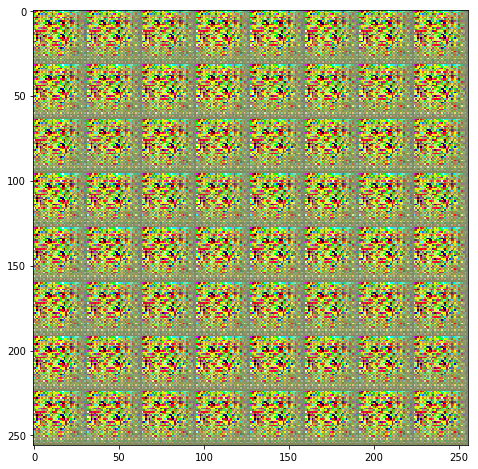

Epoch: [ 0] [  98/ 600] time: 36.3195, d_loss: 0.69304180, g_loss: 1.70505846


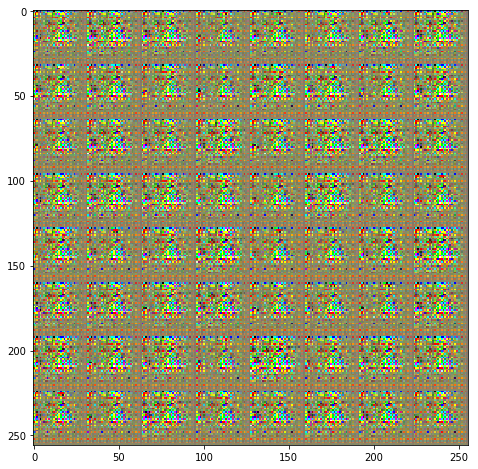

Epoch: [ 0] [ 198/ 600] time: 66.6997, d_loss: 0.06849010, g_loss: 3.75571513


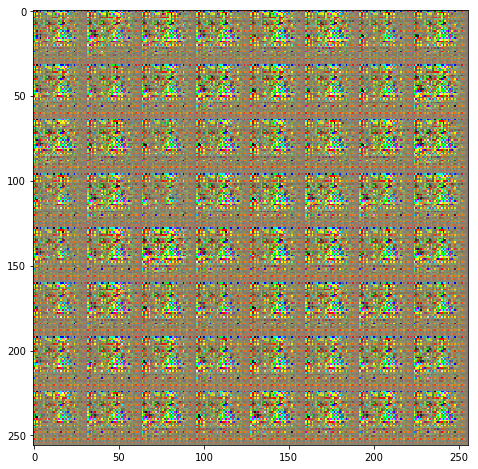

Epoch: [ 0] [ 298/ 600] time: 97.1945, d_loss: 0.02640670, g_loss: 4.99230003


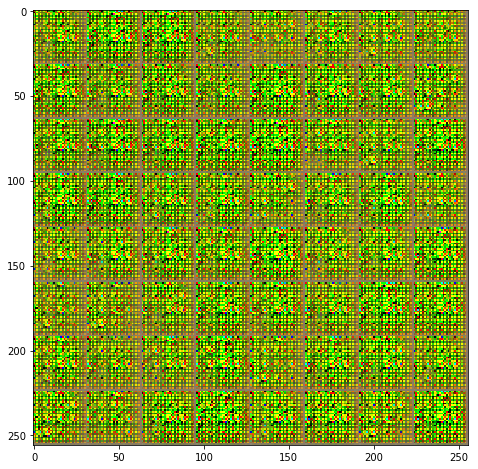

Epoch: [ 0] [ 398/ 600] time: 127.7981, d_loss: 0.83937508, g_loss: 1.42937648


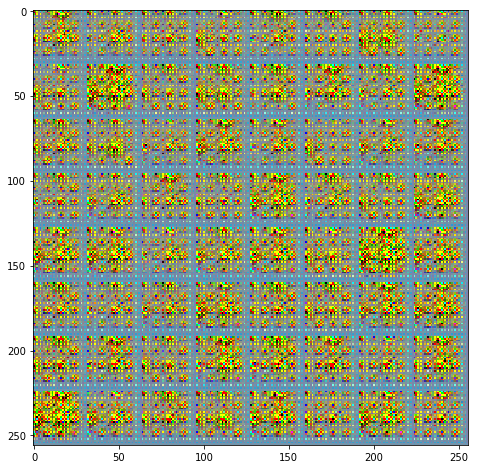

Epoch: [ 0] [ 498/ 600] time: 158.4701, d_loss: 0.01729865, g_loss: 4.68000507


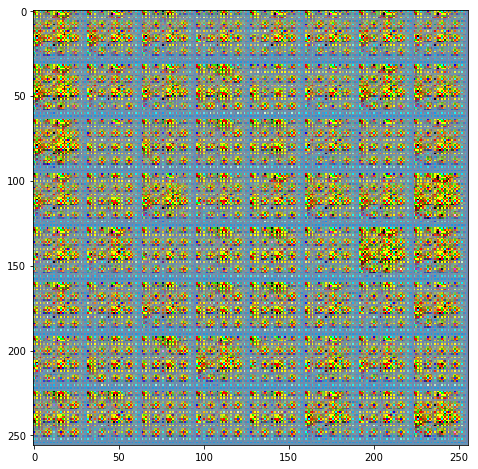

Epoch: [ 0] [ 598/ 600] time: 189.1285, d_loss: 0.01169523, g_loss: 5.67768908


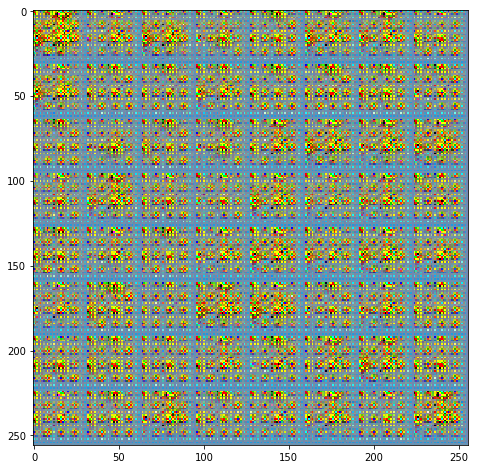

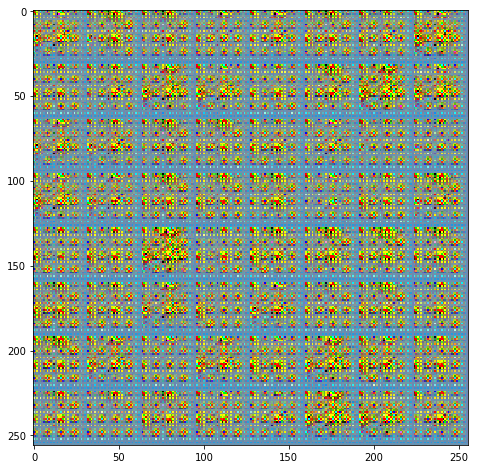

Epoch: [ 1] [  98/ 600] time: 221.1125, d_loss: 0.01950194, g_loss: 6.07225084


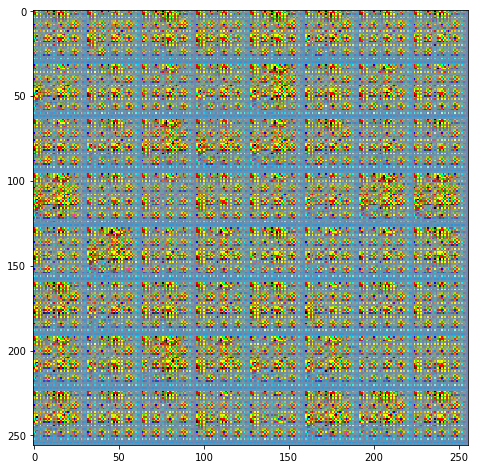

Epoch: [ 1] [ 198/ 600] time: 251.7864, d_loss: 0.00284542, g_loss: 6.64540958


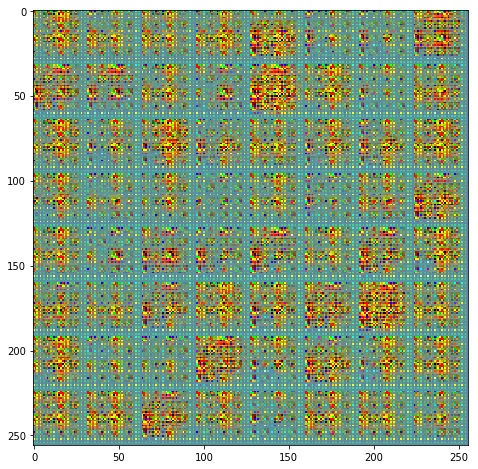

Epoch: [ 1] [ 298/ 600] time: 282.4562, d_loss: 0.03305342, g_loss: 4.46081161


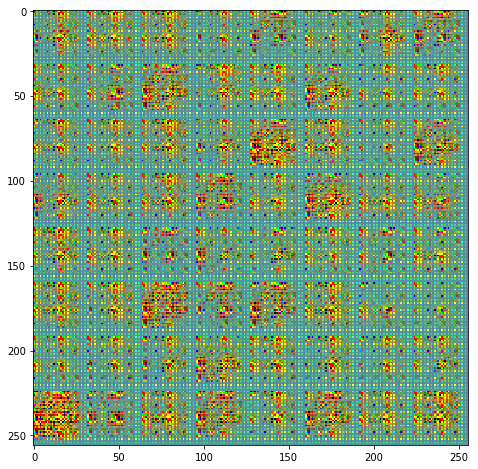

Epoch: [ 1] [ 398/ 600] time: 313.1732, d_loss: 0.00626915, g_loss: 5.55641127


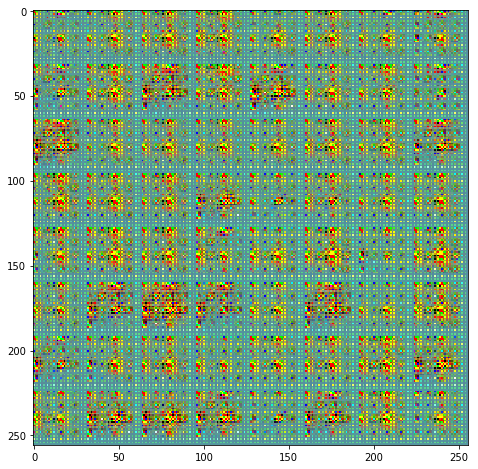

Epoch: [ 1] [ 498/ 600] time: 343.8802, d_loss: 0.00415478, g_loss: 5.89299679


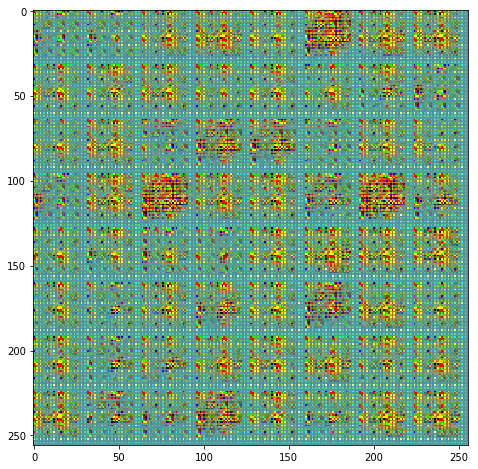

Epoch: [ 1] [ 598/ 600] time: 374.6086, d_loss: 0.00293638, g_loss: 6.39246035


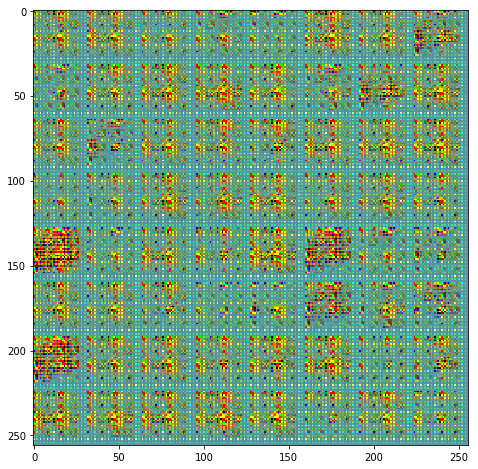

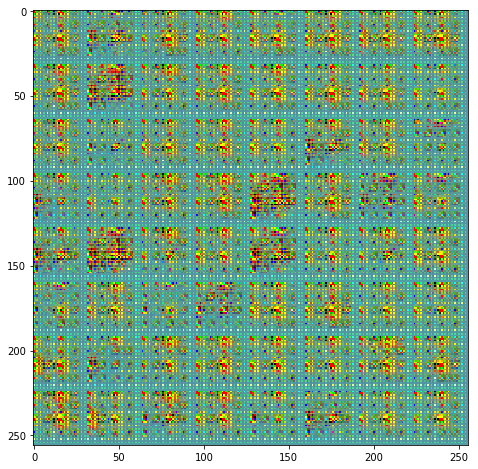

Epoch: [ 2] [  98/ 600] time: 406.2635, d_loss: 0.00589428, g_loss: 7.12251997


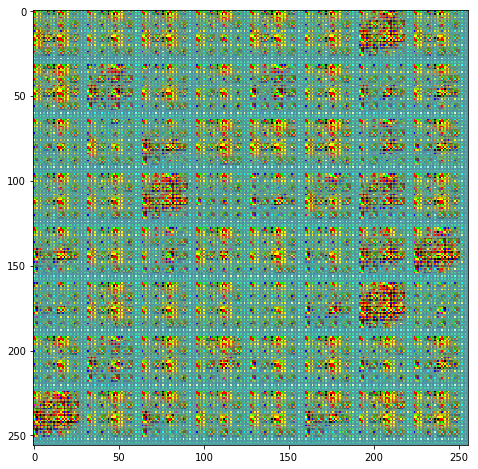

Epoch: [ 2] [ 198/ 600] time: 436.9531, d_loss: 0.00142719, g_loss: 6.95368910


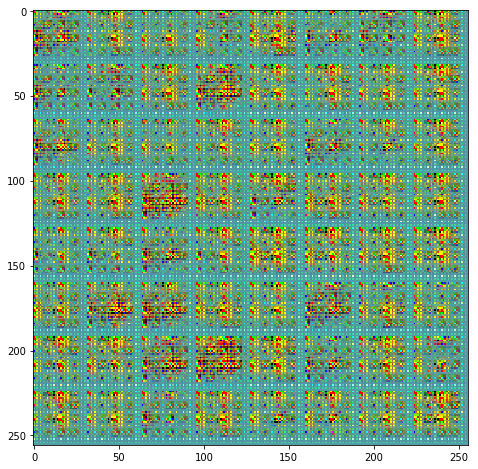

Epoch: [ 2] [ 298/ 600] time: 467.6136, d_loss: 0.00216154, g_loss: 6.65498066


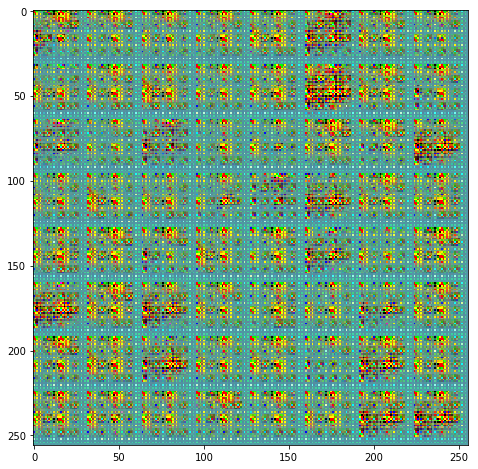

Epoch: [ 2] [ 398/ 600] time: 498.3273, d_loss: 0.00122701, g_loss: 7.12731123


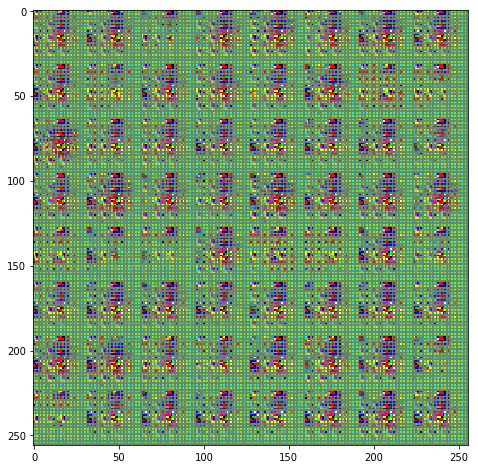

Epoch: [ 2] [ 498/ 600] time: 529.0330, d_loss: 0.01638185, g_loss: 4.88893938


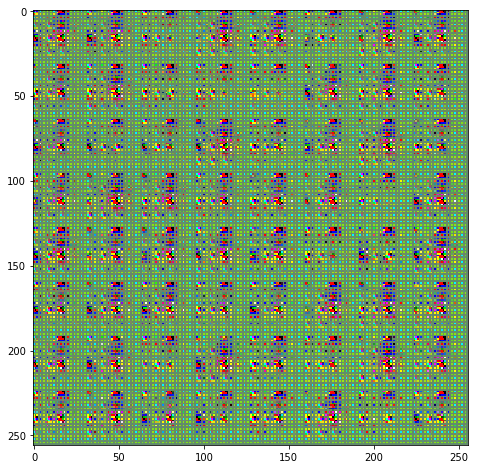

Epoch: [ 2] [ 598/ 600] time: 559.7511, d_loss: 0.00606665, g_loss: 6.40926218


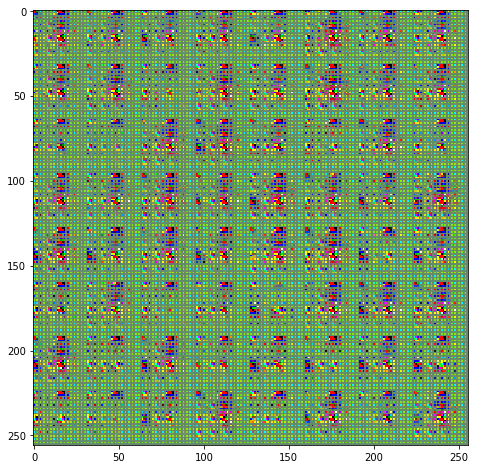

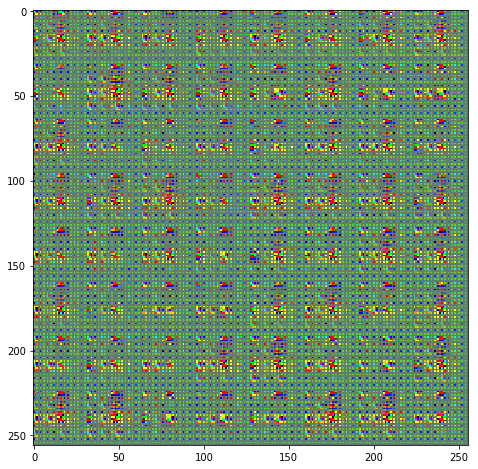

Epoch: [ 3] [  98/ 600] time: 591.3571, d_loss: 0.07777813, g_loss: 5.12428951


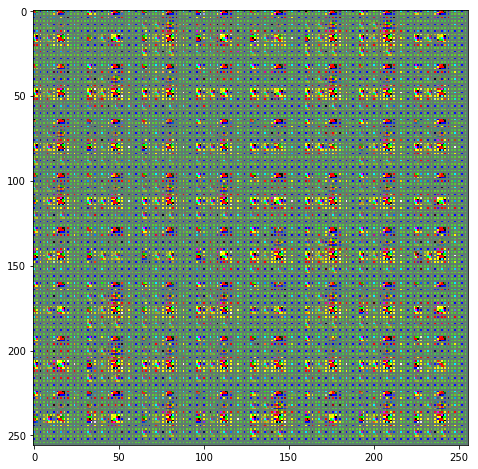

Epoch: [ 3] [ 198/ 600] time: 622.0404, d_loss: 0.00415633, g_loss: 5.97688913


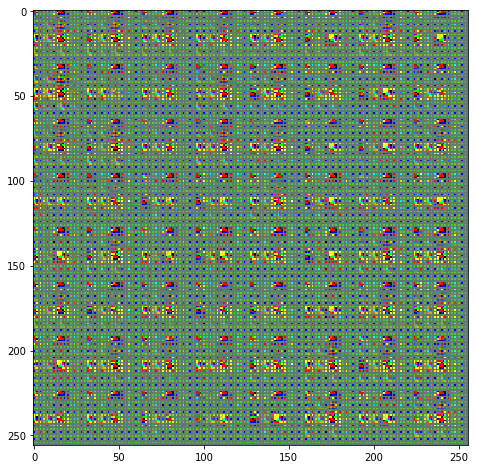

Epoch: [ 3] [ 298/ 600] time: 652.7197, d_loss: 0.00623041, g_loss: 6.21048212


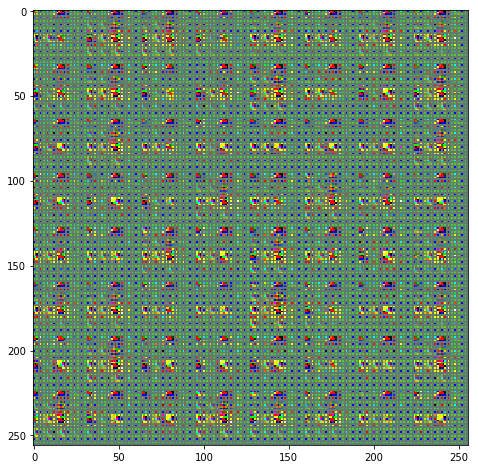

Epoch: [ 3] [ 398/ 600] time: 683.3791, d_loss: 0.00193249, g_loss: 6.79360151


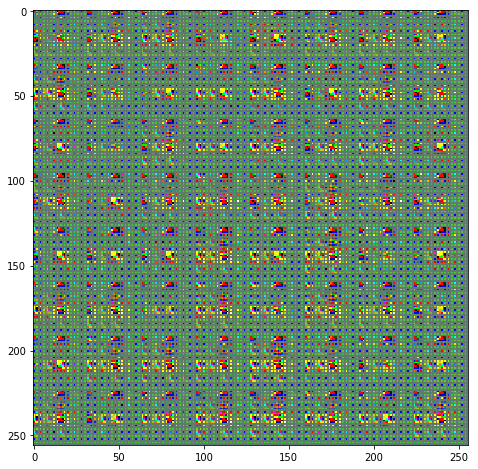

Epoch: [ 3] [ 498/ 600] time: 714.0486, d_loss: 0.00120359, g_loss: 6.94431210


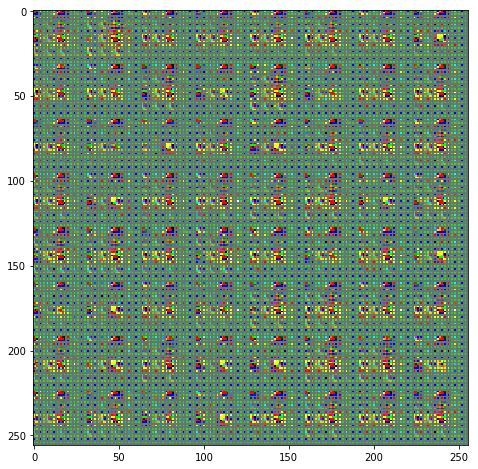

Epoch: [ 3] [ 598/ 600] time: 744.7251, d_loss: 0.00207568, g_loss: 7.13423014


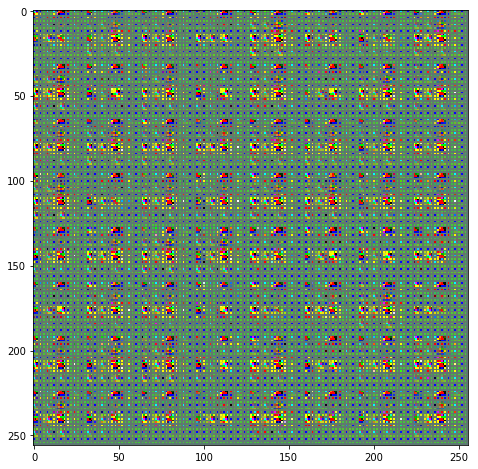

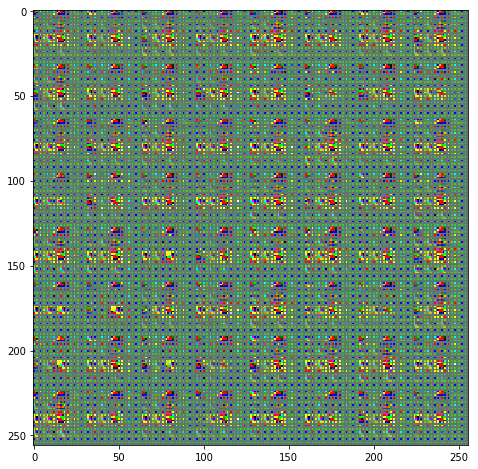

Epoch: [ 4] [  98/ 600] time: 776.3746, d_loss: 0.00425729, g_loss: 7.04287767


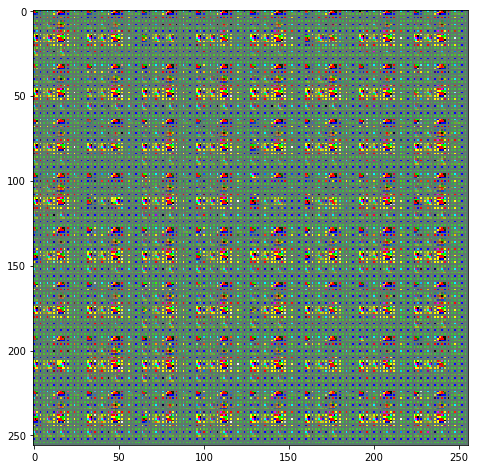

Epoch: [ 4] [ 198/ 600] time: 807.1137, d_loss: 0.00125738, g_loss: 7.06600475


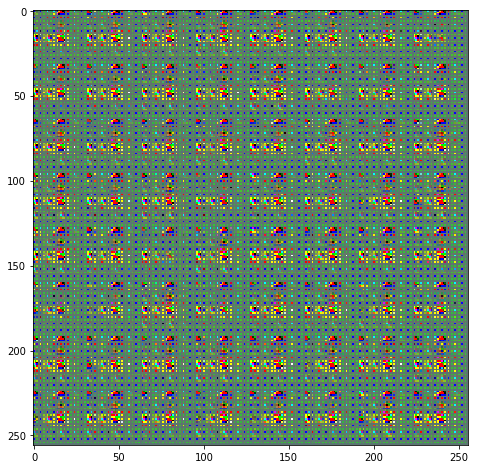

Epoch: [ 4] [ 298/ 600] time: 837.8301, d_loss: 0.00365699, g_loss: 6.30602741


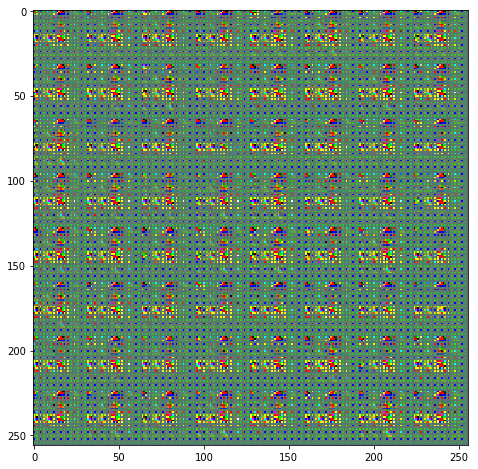

Epoch: [ 4] [ 398/ 600] time: 868.5592, d_loss: 0.00096014, g_loss: 7.85164690


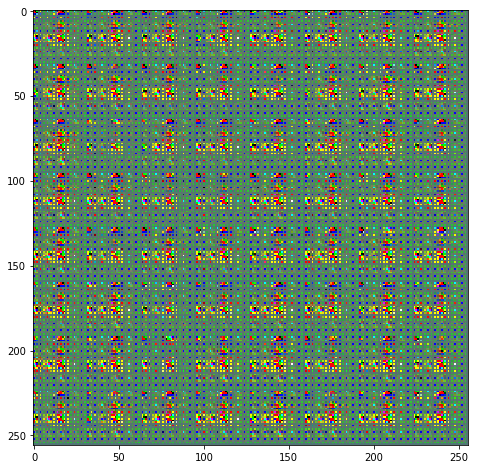

Epoch: [ 4] [ 498/ 600] time: 899.2875, d_loss: 0.00081638, g_loss: 7.95212650


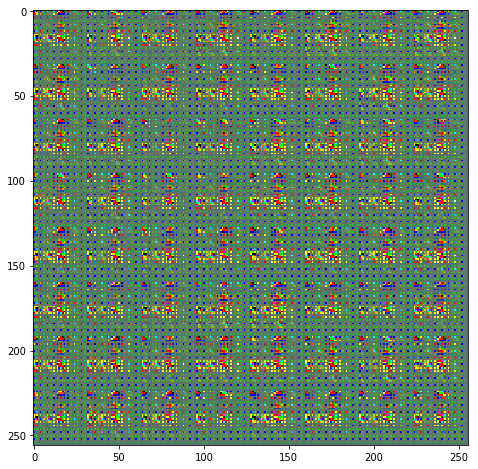

Epoch: [ 4] [ 598/ 600] time: 930.0091, d_loss: 0.00105519, g_loss: 7.63457155


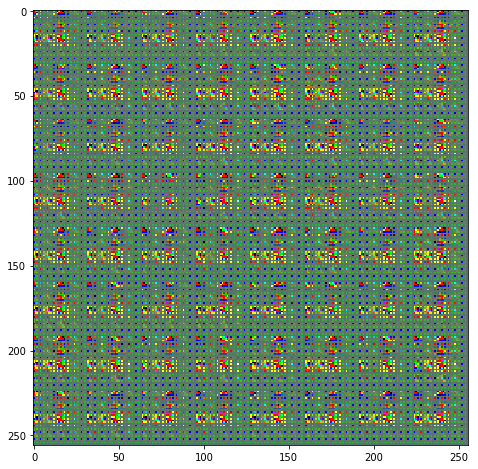

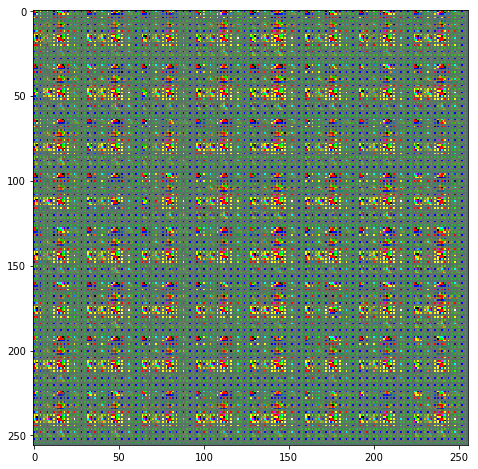

Epoch: [ 5] [  98/ 600] time: 961.6944, d_loss: 0.00176348, g_loss: 7.91117477


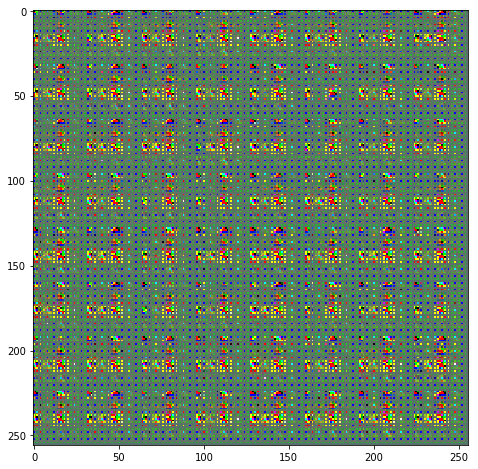

Epoch: [ 5] [ 198/ 600] time: 992.3741, d_loss: 0.00043648, g_loss: 8.30080318


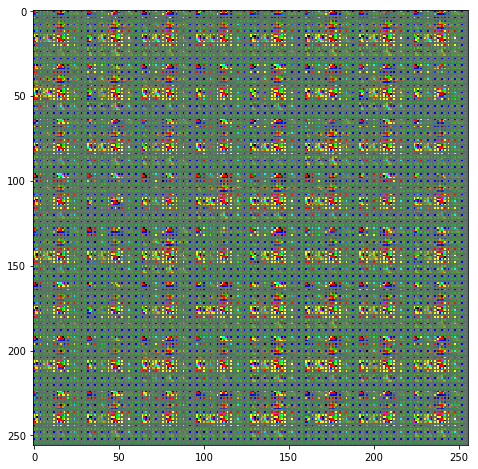

Epoch: [ 5] [ 298/ 600] time: 1023.1065, d_loss: 0.00061735, g_loss: 8.46266460


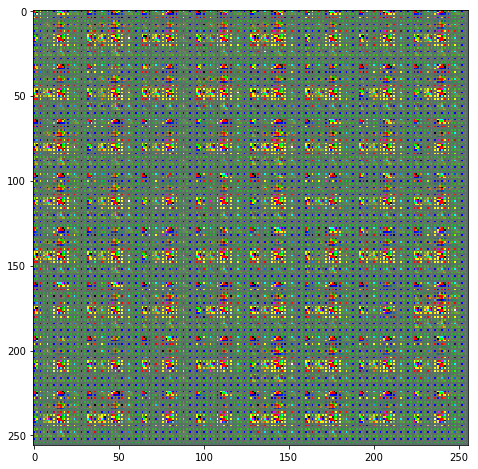

Epoch: [ 5] [ 398/ 600] time: 1053.8238, d_loss: 0.00041674, g_loss: 8.43998814


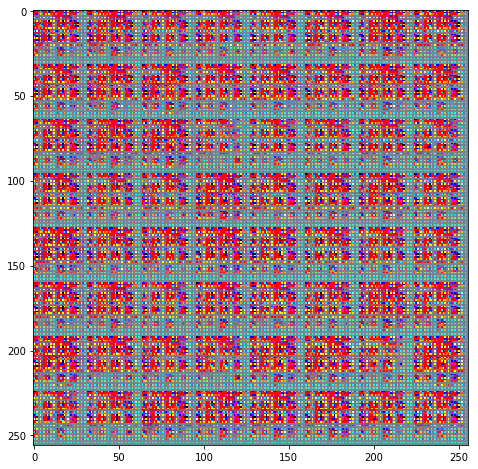

Epoch: [ 5] [ 498/ 600] time: 1084.4828, d_loss: 0.08034815, g_loss: 3.49319530


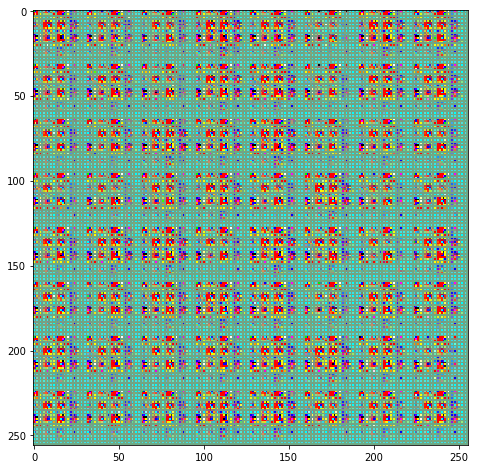

Epoch: [ 5] [ 598/ 600] time: 1115.1419, d_loss: 0.01041810, g_loss: 5.69723272


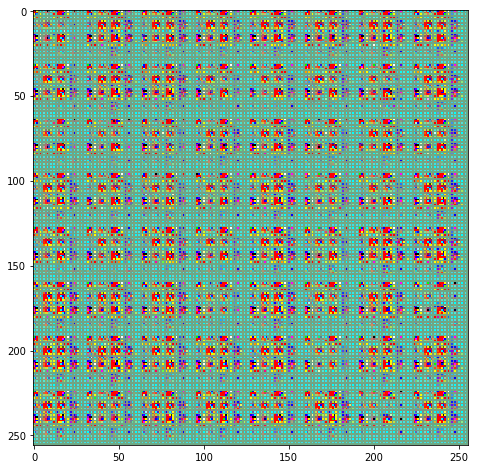

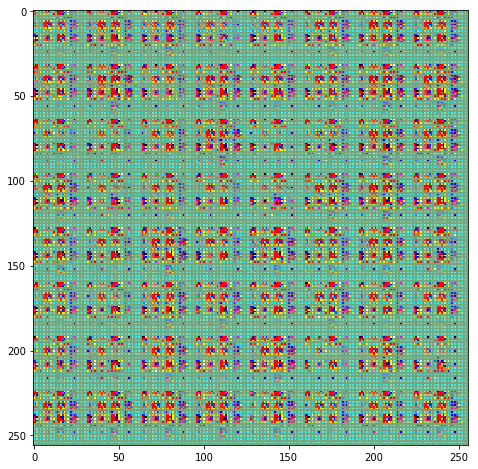

Epoch: [ 6] [  98/ 600] time: 1146.7366, d_loss: 0.01226745, g_loss: 6.35094500


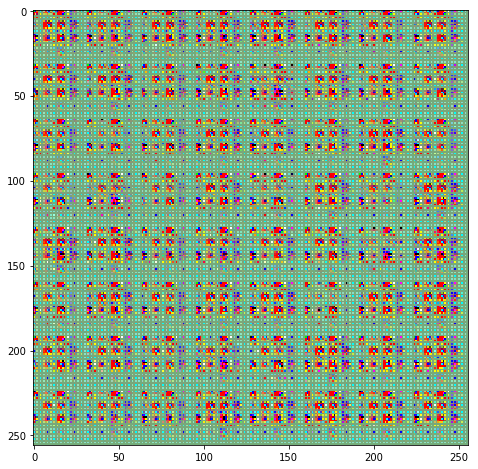

Epoch: [ 6] [ 198/ 600] time: 1177.4100, d_loss: 0.00213002, g_loss: 6.70047951


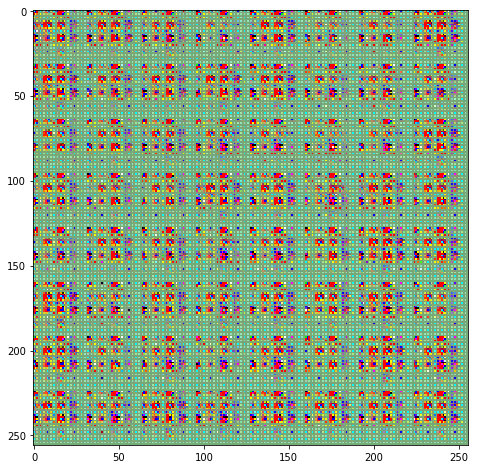

Epoch: [ 6] [ 298/ 600] time: 1208.1138, d_loss: 0.00598826, g_loss: 6.88742352


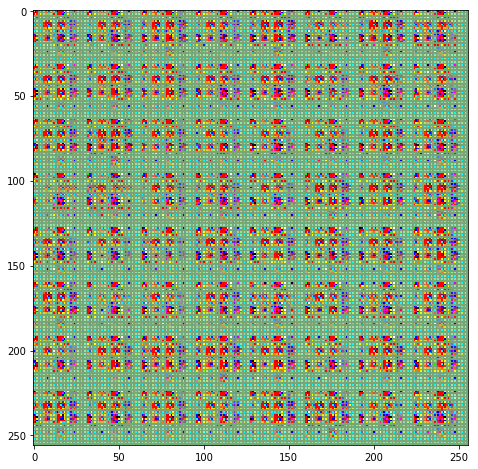

Epoch: [ 6] [ 398/ 600] time: 1238.7992, d_loss: 0.00131564, g_loss: 7.09858322


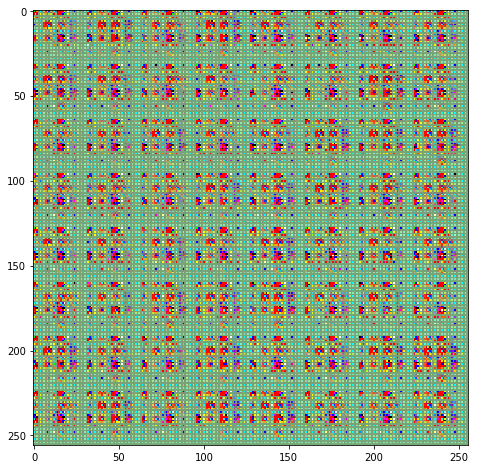

Epoch: [ 6] [ 498/ 600] time: 1269.4847, d_loss: 0.00126784, g_loss: 7.01904249


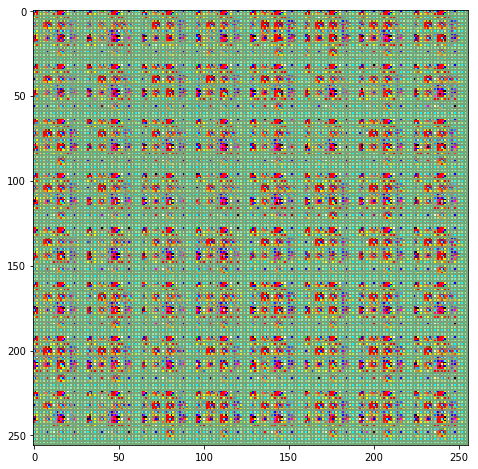

Epoch: [ 6] [ 598/ 600] time: 1300.1685, d_loss: 0.00120682, g_loss: 7.95434427


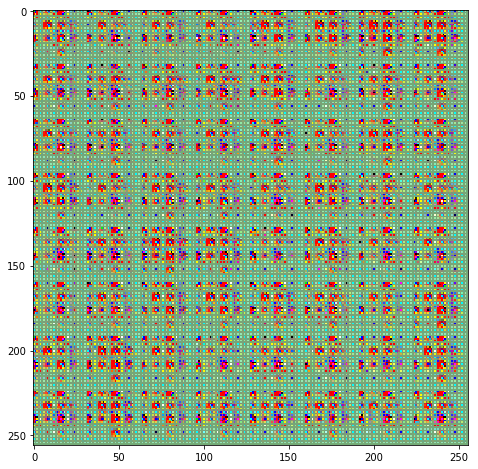

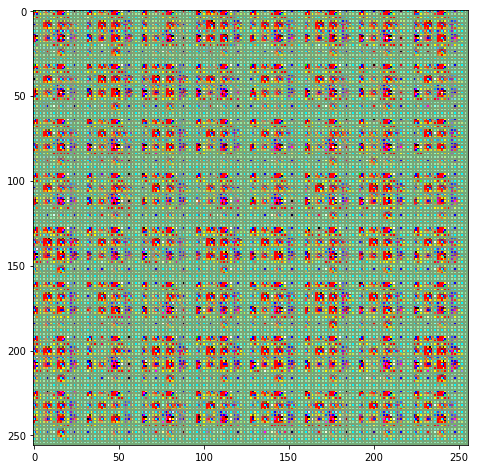

Epoch: [ 7] [  98/ 600] time: 1331.7945, d_loss: 0.00264529, g_loss: 7.75450325


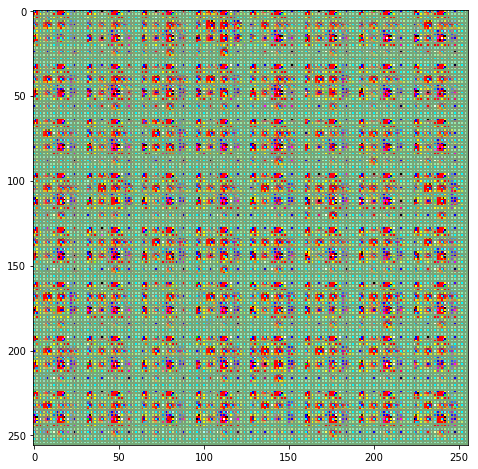

Epoch: [ 7] [ 198/ 600] time: 1362.5036, d_loss: 0.00063987, g_loss: 7.86458874


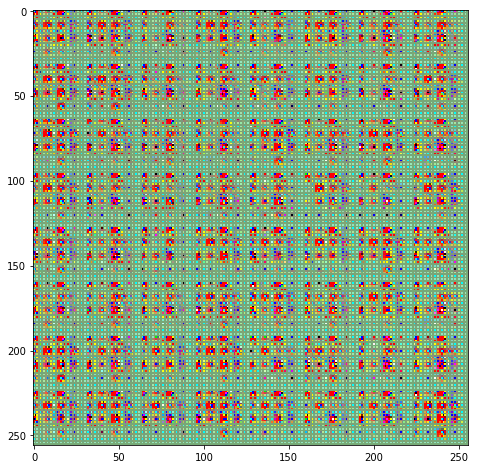

Epoch: [ 7] [ 298/ 600] time: 1393.2226, d_loss: 0.00413544, g_loss: 7.93126583


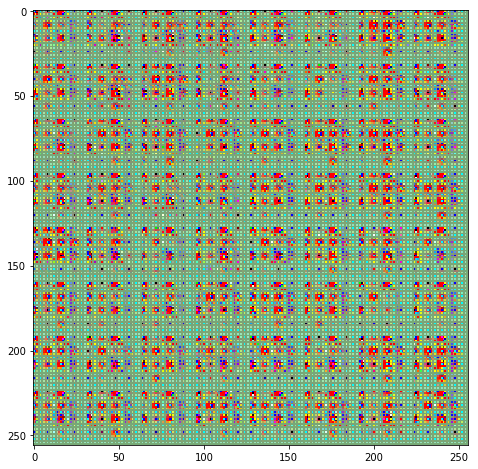

Epoch: [ 7] [ 398/ 600] time: 1423.8801, d_loss: 0.00060137, g_loss: 8.13603783


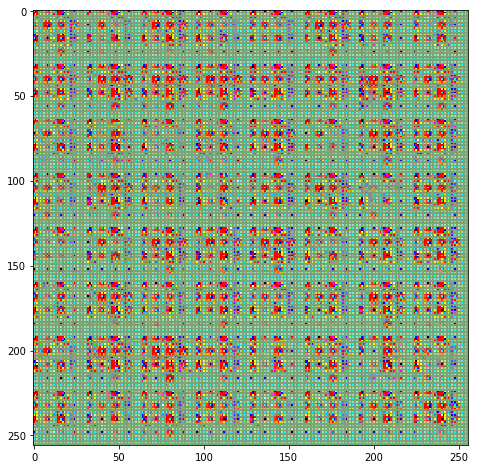

Epoch: [ 7] [ 498/ 600] time: 1454.5898, d_loss: 0.00073201, g_loss: 7.56195450


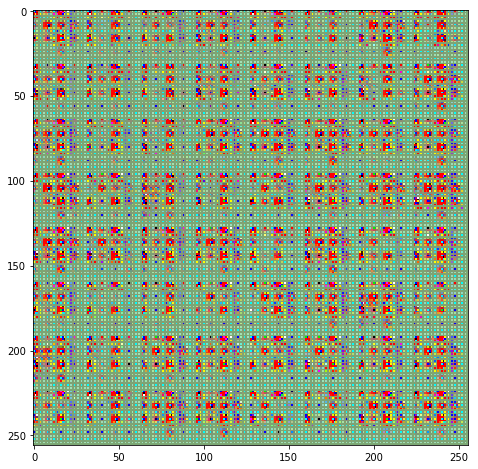

Epoch: [ 7] [ 598/ 600] time: 1485.4545, d_loss: 0.00117430, g_loss: 7.61650133


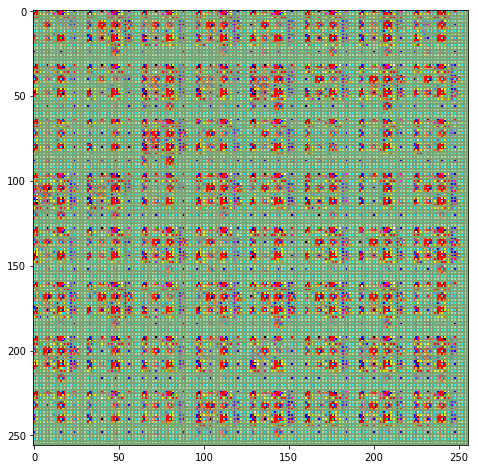

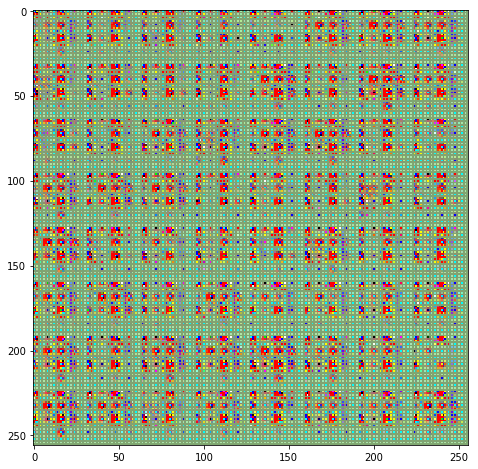

Epoch: [ 8] [  98/ 600] time: 1517.1195, d_loss: 0.00056096, g_loss: 8.51957989


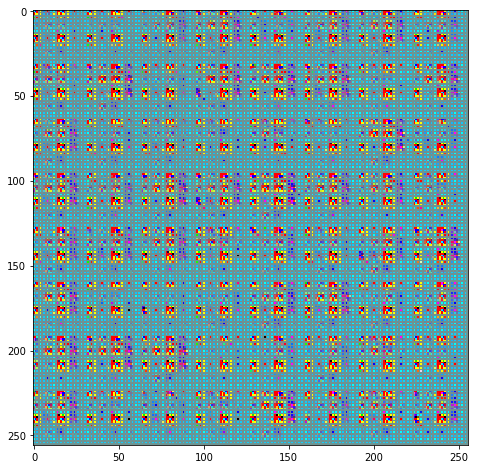

Epoch: [ 8] [ 198/ 600] time: 1547.7987, d_loss: 0.05050769, g_loss: 4.07093525


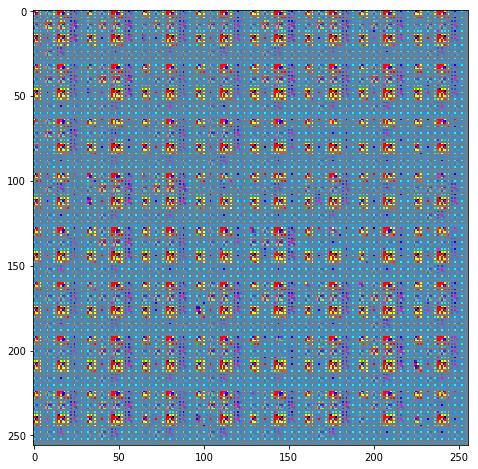

Epoch: [ 8] [ 298/ 600] time: 1578.4273, d_loss: 0.00645975, g_loss: 5.66194773


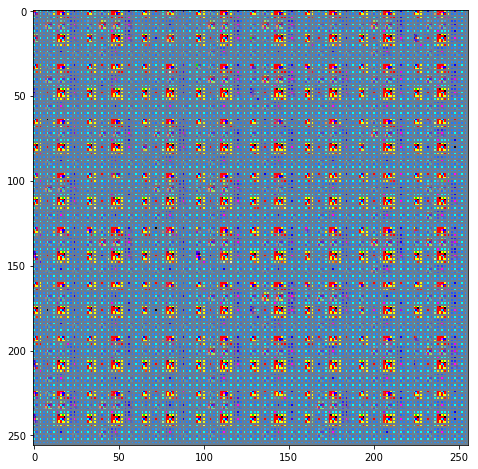

Epoch: [ 8] [ 398/ 600] time: 1609.1344, d_loss: 0.00489343, g_loss: 7.08474541


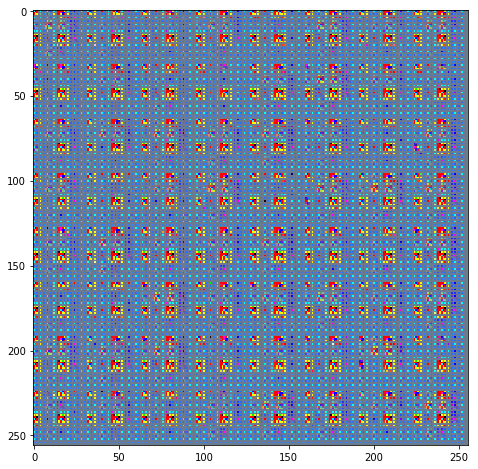

Epoch: [ 8] [ 498/ 600] time: 1639.8360, d_loss: 0.00300704, g_loss: 6.77443314


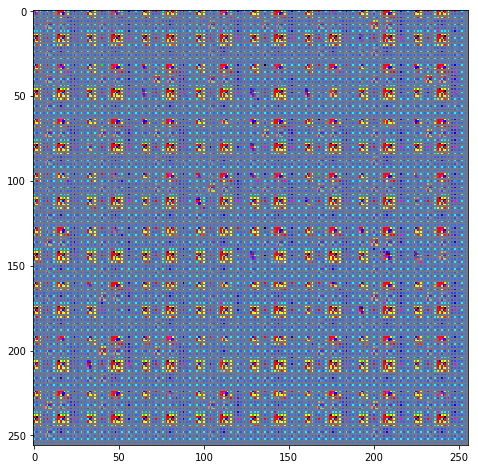

Epoch: [ 8] [ 598/ 600] time: 1670.5378, d_loss: 0.00144314, g_loss: 7.05974197


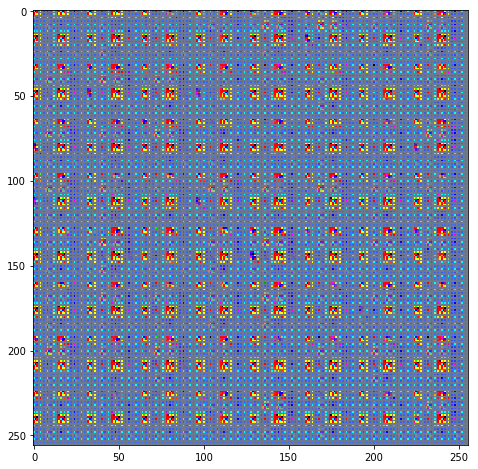

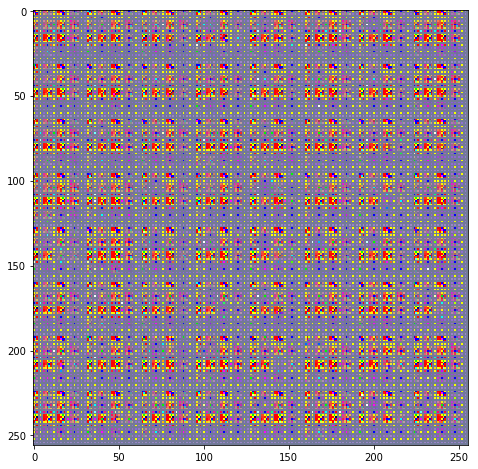

Epoch: [ 9] [  98/ 600] time: 1702.1819, d_loss: 0.58696651, g_loss: 3.68352985


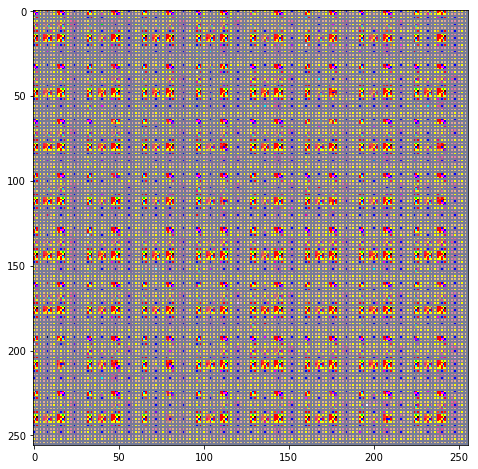

Epoch: [ 9] [ 198/ 600] time: 1732.8587, d_loss: 0.01132113, g_loss: 5.30050611


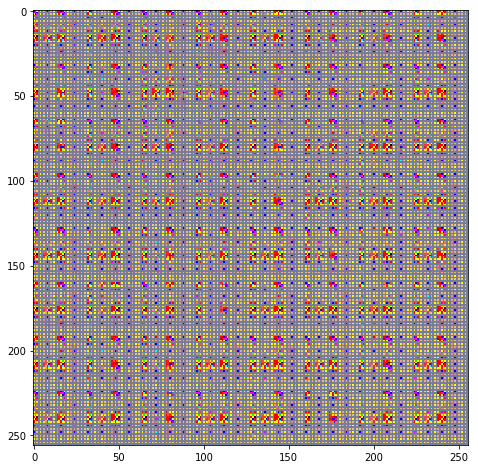

Epoch: [ 9] [ 298/ 600] time: 1763.5522, d_loss: 0.00587448, g_loss: 5.58937693


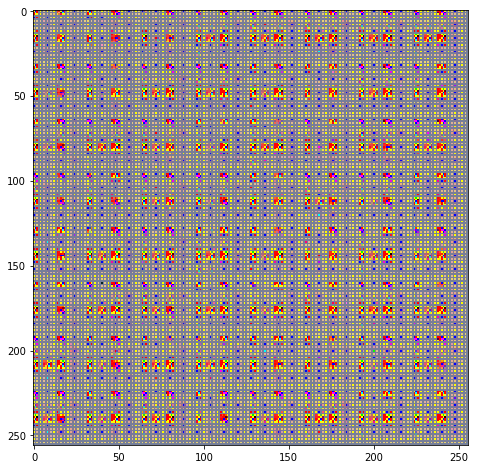

Epoch: [ 9] [ 398/ 600] time: 1794.2526, d_loss: 0.00474606, g_loss: 5.74758291


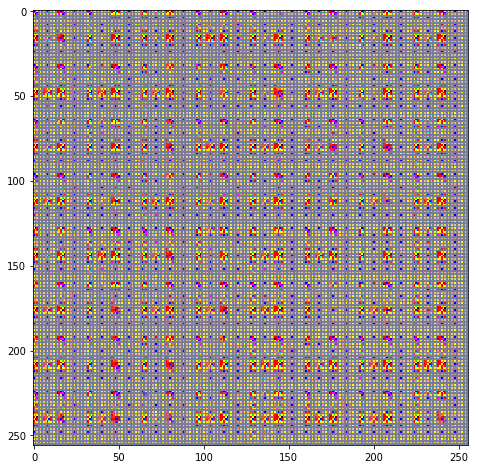

Epoch: [ 9] [ 498/ 600] time: 1824.9413, d_loss: 0.00656618, g_loss: 6.48910332


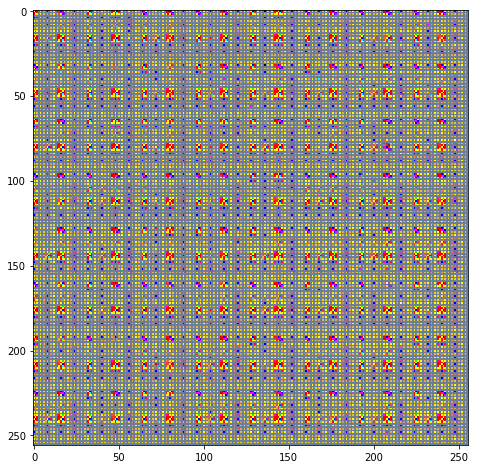

Epoch: [ 9] [ 598/ 600] time: 1855.6353, d_loss: 0.00521285, g_loss: 5.81840801


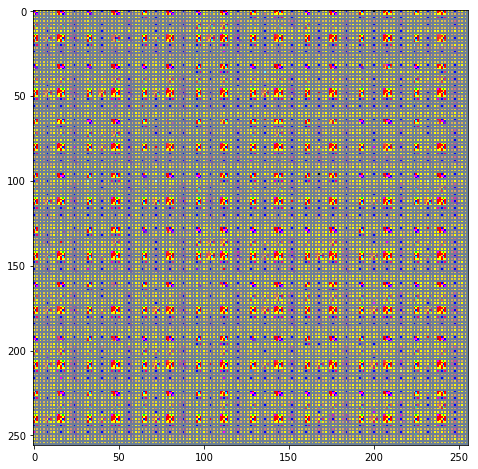

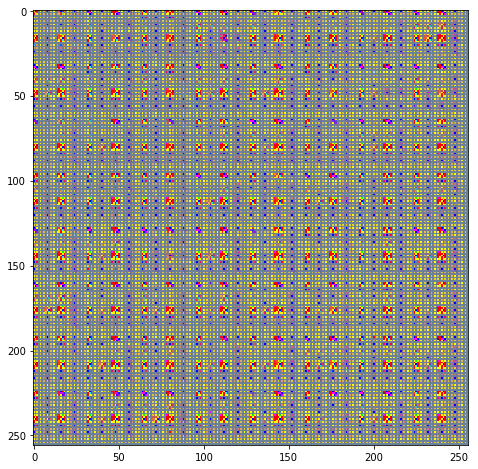

Epoch: [10] [  98/ 600] time: 1887.2747, d_loss: 0.00549635, g_loss: 6.75188971


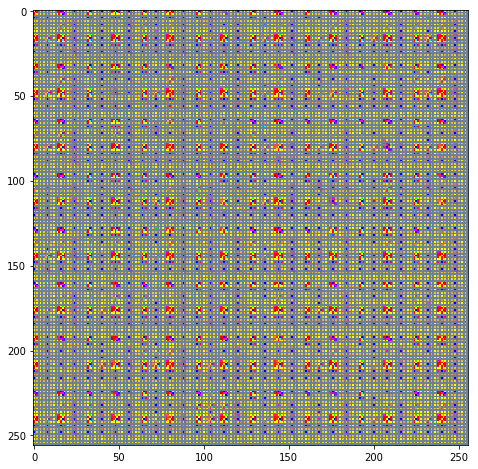

Epoch: [10] [ 198/ 600] time: 1917.9431, d_loss: 0.00245021, g_loss: 6.33035517


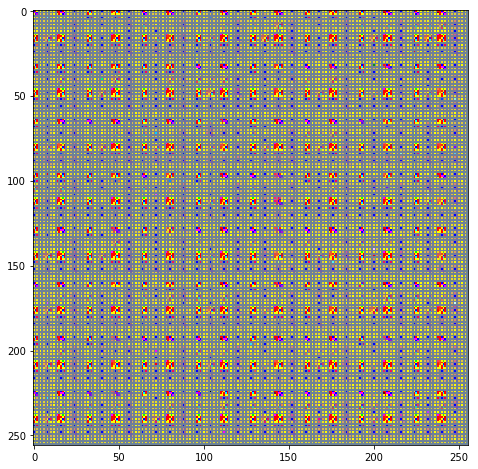

Epoch: [10] [ 298/ 600] time: 1948.5897, d_loss: 0.00196543, g_loss: 7.27652216


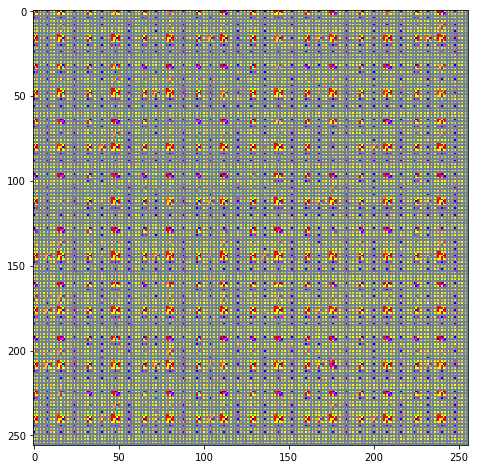

Epoch: [10] [ 398/ 600] time: 1979.2368, d_loss: 0.00302077, g_loss: 8.06194687


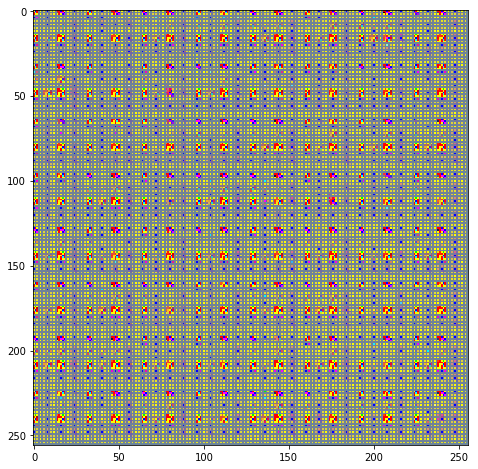

Epoch: [10] [ 498/ 600] time: 2009.8726, d_loss: 0.00099412, g_loss: 8.15227413


In [ ]:
# Training Parameters
epoch = 50
batch_size = 100
checkpoint_dir = 'checkpoint_res'
result_dir = 'results_res'
log_dir = 'logs_res'
# open session
with tf.Session(config=tf.ConfigProto(allow_soft_placement=True)) as sess:
    gan = GAN(sess, epoch=epoch, batch_size=batch_size,
                checkpoint_dir=checkpoint_dir, result_dir=result_dir, log_dir=log_dir)
    # build graph
    gan.build_model()

    # show network architecture
    show_all_variables()

    # launch the graph in a session
    gan.train()
    print(" [*] Training finished!")

    # visualize learned generator
    gan.visualize_results(gan.epoch-1)
    print(" [*] Testing finished!")
